<a href="https://colab.research.google.com/github/fazekas-gergo/composer-ai/blob/master/ComposerAI_ipynb_multioutput_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Composer AI
Authors: Fazekas Gergő and Joseph Tadrous<br>
Used dataset: https://www.kaggle.com/soumikrakshit/classical-music-midi

---
## 1. First steps
At first clone the repository (which also contains the dataset) and install the required packages.

In [ ]:
!git clone -l -s https://github.com/fazekas-gergo/composer-ai composer-ai
%cd composer-ai
!pip install midi2audio
!pip install py_midicsv
!pip install pretty_midi
!sudo apt-get install fluidsynth

In [2]:
import os
import pretty_midi
import collections
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import music21
from sklearn.preprocessing import MinMaxScaler

from midi2audio import FluidSynth
from IPython.display import Audio

---
## 2. Data Exploration

At first let's create a list, which contains all the midi files from the dataset.

In [4]:
def get_midi_file_paths(main_folder):
  files = []
  for dir in os.listdir(main_folder):
    for file in os.listdir(main_folder + os.path.sep + dir):
      files.append(main_folder + os.path.sep + dir + os.path.sep + file)
  return files

midi_file_paths = get_midi_file_paths('classical_music_midi')
print('Number of read MIDI files:', len(midi_file_paths))

Number of read MIDI files: 295


The *music21* package lets us to plot the midi file.

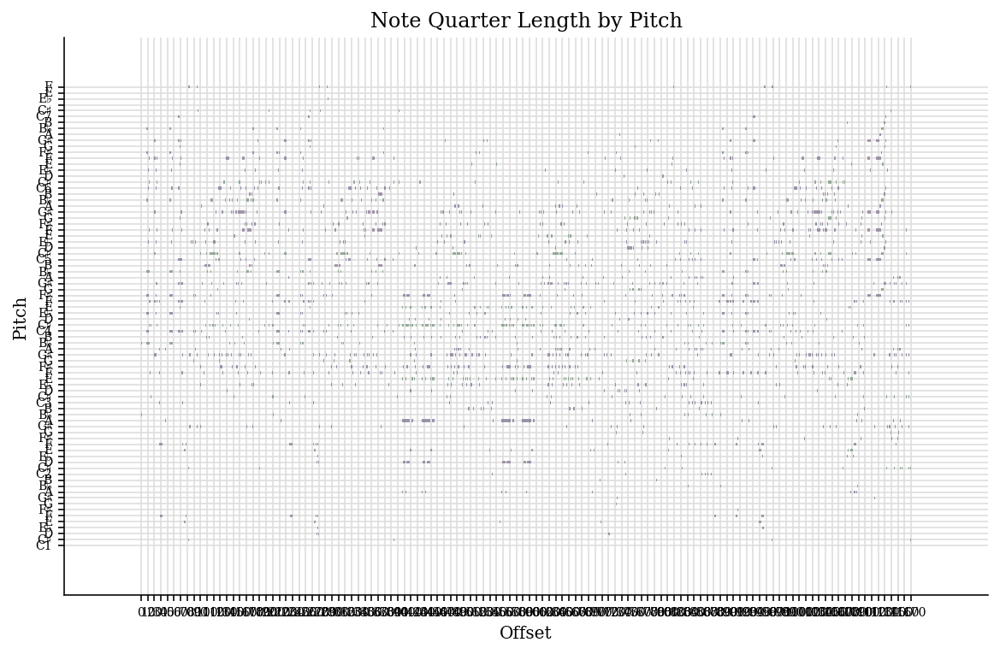

In [5]:
music = music21.converter.parse(midi_file_paths[251])
music.plot()

The convert_midi_to_flac function is able to convert the midi file to be listenable by using a soundfont file.

In [6]:
def convert_midi_to_flac(music_path, output='music'):
  FluidSynth('piano.sf2').midi_to_audio(music_path, 'music' + '.flac')
  return 'music' + '.flac'

def play_music(music_path):
  convert_midi_to_flac(music_path, output='music')
  return 'music.flac'

Audio(play_music(midi_file_paths[251]))

---
## 3. Create Data Frame

Create a pandas data frame filled with the pitches and durations of the notes sorted by the start time.<br>

In [13]:
arr = [2, 3, 4, 5, None]
list(filter(None, arr))

[2, 3, 4, 5]

In [31]:
from pretty_midi.instrument import Instrument

def midi_files_to_df(paths):
  data_frames = [midi_file_to_df(file_path) for file_path in paths]
  names = list(map(lambda p: p.replace("classical_music_midi/", ""), paths))
  return pd.concat(data_frames, keys=names)

def midi_file_to_df(midi_file_name: str):
  m = pretty_midi.PrettyMIDI(midi_file_name)
  piano_left = list(filter(lambda inst: inst.name.lower() == 'piano left', m.instruments))
  piano_right = list(filter(lambda inst: inst.name.lower() == 'piano right', m.instruments))
  if len(piano_left) == 1 and len(piano_right) == 1:
    print('use file:', midi_file_name)
    return __piano_to_df(piano_left[0], piano_right[0])
  else:
    print('ignore file:', midi_file_name)

def __piano_to_df(piano_left: Instrument, piano_right: Instrument):
  piano_notes_df = __create_df_from_piano_notes(piano_left, piano_right)
  return __group_notes(piano_notes_df)
  

def __create_df_from_piano_notes(piano_left: Instrument, piano_right: Instrument):
  piano_left_df = __create_df_from_instrument_notes(piano_left)
  piano_right_df = __create_df_from_instrument_notes(piano_right)
  return pd.concat([piano_left_df, piano_right_df]).sort_values(['start']).reset_index()

def __create_df_from_instrument_notes(instrument: Instrument):
  return pd.DataFrame([{
        'start': n.start, 
        'end': n.end, 
        'pitch': n.pitch, 
        'velocity': n.velocity
    } for n in instrument.notes])

def __group_notes(df: pd.DataFrame):
  dataset = []
  for start, note_df in df.groupby(['start'], sort=True):
    pitches = __create_pitch_arr(note_df)
    velocity = note_df['velocity'].mean()
    dataset.append([pitches, velocity, start])
  new_df = pd.DataFrame(dataset, columns=['pitches', 'velocity', 'start'])
  new_df['duration'] = new_df['start'].diff(periods=-1)*(-1)
  return new_df.drop(['start'], axis=1).iloc[:-1]

def __create_pitch_arr(note_df):
  return [int(d['pitch']) for _, d in note_df.sort_values(['pitch']).iterrows()]

dataset = midi_files_to_df(midi_file_paths[0:10])
dataset

use file: classical_music_midi/albeniz/alb_se8.mid
use file: classical_music_midi/albeniz/alb_esp6.mid
use file: classical_music_midi/albeniz/alb_esp5.mid
use file: classical_music_midi/albeniz/alb_se5.mid
use file: classical_music_midi/albeniz/alb_se2.mid
use file: classical_music_midi/albeniz/alb_esp3.mid
use file: classical_music_midi/albeniz/alb_esp1.mid
use file: classical_music_midi/albeniz/alb_se6.mid
use file: classical_music_midi/albeniz/alb_esp4.mid
use file: classical_music_midi/albeniz/alb_se7.mid


pitches  velocity  duration
albeniz/alb_se8.mid 0    [39, 51, 58, 63, 67]      41.4  0.252165
                    1                    [57]      37.0  0.252165
                    2                    [58]      38.0  0.252165
                    3                    [55]      45.0  0.255319
                    4    [34, 46, 55, 63, 67]      44.4  0.241936
...                                       ...       ...       ...
albeniz/alb_se7.mid 932                  [42]      61.0  0.024886
                    933                  [49]      61.0  0.024885
                    934  [58, 82, 85, 90, 94]      86.2  1.017456
                    935                  [54]      62.0  0.020643
                    936                  [61]      62.0  0.020643

[9214 rows x 3 columns]

In [33]:
dataset.describe()

,velocity,duration
count,9214.000000,9214.000000
mean,50.052524,0.207218
std,11.567618,0.181889
min,15.000000,0.006494
25%,42.000000,0.113636
50%,49.750000,0.169492
75%,57.000000,0.260869
max,107.000000,3.144102


# 4. Prepare data

Scale duration and velocity columns.

In [37]:
scaler = MinMaxScaler()
scaler.fit(dataset[['duration', 'velocity']])
scaled = scaler.transform(dataset[['duration', 'velocity']])

dataset_prepared = dataset
dataset_prepared[['duration', 'velocity']] = scaler.transform(dataset[['duration', 'velocity']])
dataset_prepared.describe()

,velocity,duration
count,9214.000000,9214.000000
mean,0.381006,0.063974
std,0.125735,0.057971
min,0.000000,0.000000
25%,0.293478,0.034148
50%,0.377717,0.051950
75%,0.456522,0.081073
max,1.000000,1.000000


Tokenize pitches column

In [42]:
def create_token_from_pitches(pitches):
  note = np.zeros(108-21, dtype=int)
  for pitch in pitches:
    note[pitch - 21] = 1
  return note

dataset_prepared['pitches'] = dataset['pitches'].apply(create_token_from_pitches)
dataset_prepared

pitches  \
albeniz/alb_se8.mid 0    [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    1    [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    2    [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    3    [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    4    [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
...                                                                    ...   
albeniz/alb_se7.mid 932  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    933  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    934  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    935  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   
                    936  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...   

                         velocity  duration  
albeniz/alb_se8.mid 0    0.286957  0.078299  
                    1    0.239130  0.078299  
                    2    0.250000  0.078299  
                    3    0.326087  0.079304  
                    4    0.319565  0.075039  
...                           ...       ...  
albeniz/alb_se7.mid 932  0.500000  0.005862  
                    933  0.500000  0.005862  
                    934  0.773913  0.322208  
                    935  0.510870  0.004510  
                    936  0.510870  0.004510  

[9214 rows x 3 columns]

Window dataset

In [63]:
window_size = 2

In [75]:
def make_timeseries_instances(timeseries, window_size):
    timeseries = np.asarray(timeseries)
    assert 0 < window_size < timeseries.shape[0] , "Out of range 0 < {} < {} ".format(window_size,timeseries.shape[0])
    X = np.atleast_3d(np.array([timeseries[start:start + window_size] for start in range(0, timeseries.shape[0] - window_size)]))
    Y = timeseries[window_size:]
    return X, Y

In [72]:
X_dur_vel, Y_dur_vel = make_timeseries_instances(dataset_prepared[['duration', 'velocity']], window_size=window_size)
# Check
assert (X_dur_vel[window_size][0] == Y_dur_vel[0]).all()
X_dur_vel.shape, Y_dur_vel.shape

((9212, 2, 2), (9212, 2))

In [87]:
X_pitches, Y_pitches = make_timeseries_instances(np.array([arr for arr in dataset_prepared['pitches'].values]), window_size=window_size)
assert (X_pitches[window_size][0] == Y_pitches[0]).all()
X_pitches.shape, Y_pitches.shape

((9212, 2, 87), (9212, 87))



---
# Training


In [88]:
from tensorflow import keras
from tensorflow.keras.layers import LSTM, Dense, Dropout, Conv2D, Flatten, Reshape, Input, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.initializers import HeNormal
from tensorflow.keras.losses import MeanSquaredError, BinaryCrossentropy

In [ ]:
input_pitches = Input(shape=(window_size, 108-21))
input_dur_vel = Input(shape=(window_size, 2))

# the first branch operates on the pitches input
pitch_in = LSTM(108-21)(input_pitches)
pitch_in = Dense(108-21, activation="relu")(pitch_in)
pitch_in = Dense(108-21, activation="relu")(pitch_in)
pitch_in = Dense(30, activation="sigmoid")(pitch_in)
pitch_in = Model(inputs=input_pitches, outputs=pitch_in)

# the second branch opreates on the duration and velocity inputs
dur_vel_in = LSTM(5)(input_dur_vel)
dur_vel_in = Dense(64, activation="relu")(input_dur_vel)
dur_vel_in = Dense(32, activation="relu")(dur_vel_in)
dur_vel_in = Dense(4, activation="relu")(dur_vel_in)
dur_vel_in = Model(inputs=input_dur_vel, outputs=dur_vel_in)

# combine the output of the two branches
common_input = Concatenate([pitch_in.output, dur_vel_in.output])

# apply a FC layer and then a regression prediction on the
# combined outputs
common = Dense(30, activation="relu")(common_input)
pitch_output = Dense(108-21, activation="sigmoid")(common)
dur_vel_output = Dense(2, activation='sigmoid')(common)
model = Model(inputs=[pitch_in.input, dur_vel_in.input], outputs=[pitch_output.output, dur_vel_output.output])

model.compile(loss=[BinaryCrossentropy(), MeanSquaredError()], loss_weights=[0.7, 0.3], optimizer=keras.optimizers.Adam())
model.summary()

TypeError: ignored

In [ ]:
es = keras.callbacks.EarlyStopping(patience=20, monitor='val_loss', restore_best_weights=True, verbose=1)
model.fit([X_pitches, X_dur_vel], [Y_pitches, Y_dur_vel], epochs=1000, callbacks=[es], batch_size=2048, validation_split=0.1)

Save model

In [ ]:
from datetime import datetime
import subprocess

# Save model
path = "models/" + str(datetime.now().strftime("%m-%d-%Y_%H-%M-%S"))
model.save(path)

# Zip model to be downloadable
subprocess.call(['zip', '-r', path + ".zip", path])

INFO:tensorflow:Assets written to: models/04-04-2022_15-45-02/assets


INFO:tensorflow:Assets written to: models/04-04-2022_15-45-02/assets


0

---
# Transfer learning
the idea is to train the ready model with only one music piece.

In [ ]:
# TODO update
from tensorflow.keras.models import load_model

loaded_model = load_model(path)
loaded_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 64)                17408     
                                                                 
 dense (Dense)               (None, 100)               6500      
                                                                 
 dense_1 (Dense)             (None, 100)               10100     
                                                                 
 dense_2 (Dense)             (None, 50)                5050      
                                                                 
 output (Dense)              (None, 3)                 153       
                                                                 
Total params: 39,211
Trainable params: 39,211
Non-trainable params: 0
_________________________________________________________________


In [ ]:
music_file = 'classical_music_midi/mozart/mz_331_3.mid'
m = pretty_midi.PrettyMIDI(music_file)
m.instruments

[Instrument(program=0, is_drum=False, name="Piano right"),
 Instrument(program=0, is_drum=False, name="Piano left")]

In [ ]:
scaled = scaler.transform(instrument_to_df(m.instruments[0]))
df_scaled = pd.DataFrame(scaled, columns=['pitch','step','duration'])
df_scaled

,pitch,step,duration
0,0.581395,0.000000,0.154035
1,0.558140,0.214128,0.154035
2,0.546512,0.214128,0.154035
3,0.558140,0.214128,0.175047
4,0.593023,0.243108,0.154035
...,...,...,...
1507,0.639535,0.000000,0.780232
1508,0.697674,1.077777,0.780232
1509,0.558140,0.000000,0.780232
1510,0.604651,0.000000,0.780232


In [ ]:
X = sliding_window_view(df_scaled.drop(df_scaled.tail(1).index), window_shape=(win_len, 3))
X = X.reshape(X.shape[0], X.shape[2], X.shape[3])
Y = df_scaled.drop(range(win_len), axis='index').values

# Test
print((X[0].flatten() == df_scaled[0:win_len].values.flatten()).all())
print((Y[0] == df_scaled.iloc[win_len].values).all())

True
True


In [ ]:
from tensorflow.keras.optimizers import SGD
loaded_model.compile(optimizer=SGD(lr=0.0001, momentum=0.9), loss=keras.losses.MeanSquaredError())
es = keras.callbacks.EarlyStopping(patience=50, monitor='loss', restore_best_weights=True, verbose=1)
loaded_model.fit(X, Y, epochs=1000, callbacks=[es], batch_size=10)



---
# Generate music
Write output into a midi file and listen it


In [ ]:
# TODO update
def generate(num: int):
  num = num + win_len
  preds = np.zeros(shape=(num, 3))
  #preds[:win_len] = X[0]
  for i in range(num-win_len):
    input = preds[i:i+win_len].reshape(win_len, 3)
    new_pred = loaded_model.predict(preds[i:i+win_len].reshape(1, win_len, 3)).reshape(3)
    preds[i+win_len] = new_pred
  preds = preds[win_len:]
  return scaler.inverse_transform(preds.reshape(-1, 3))

generated = generate(1024)
generated = pd.DataFrame(generated, columns=['pitch',	'step',	'duration'])
generated

,pitch,step,duration
0,27.836459,0.012523,0.035971
1,29.136120,0.006776,0.045266
2,29.829660,0.005884,0.052249
3,31.862131,0.009336,0.057187
4,32.720521,0.020974,0.059171
...,...,...,...
1019,56.211028,0.007519,0.267493
1020,56.211028,0.007519,0.267493
1021,56.211028,0.007519,0.267493
1022,56.211023,0.007519,0.267493


In [ ]:
music = pretty_midi.PrettyMIDI()
piano = pretty_midi.Instrument(program=pretty_midi.instrument_name_to_program('Acoustic Grand Piano'))

start = 0
for index, p in generated.iterrows():
  note_number = round(p.pitch)
  note = pretty_midi.Note(velocity=100, pitch=note_number, 
                          start=start, end=start+p.duration)
  piano.notes.append(note)
  start += p.step

# Add the piano instrument to the PrettyMIDI object
music.instruments.append(piano)
# Write out the MIDI data
music.write('output.mid')

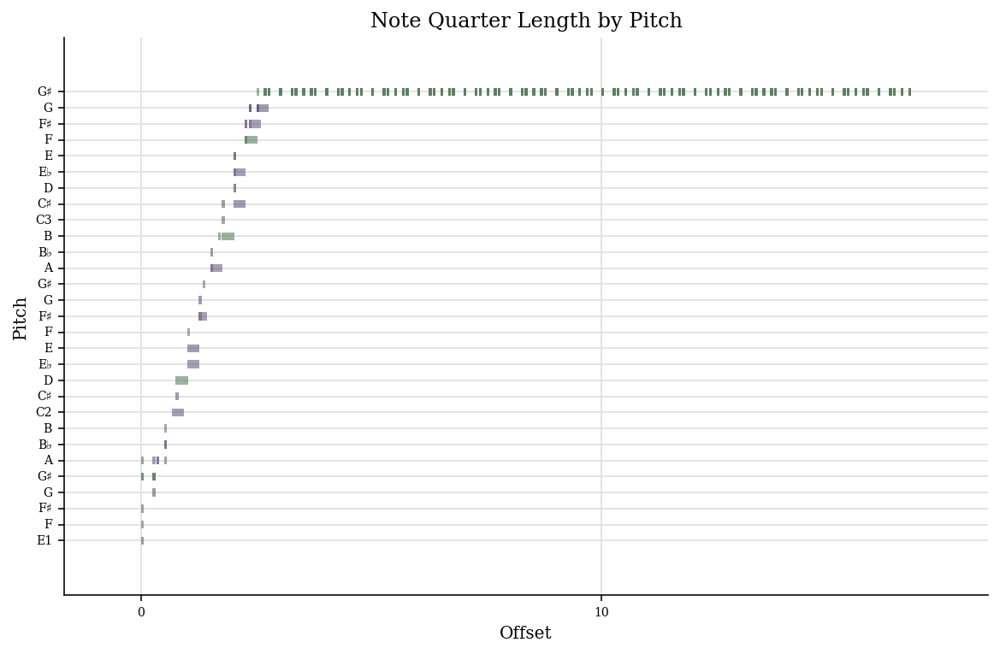

In [ ]:
music = music21.converter.parse('output.mid')
music.plot()

In [ ]:
Audio(play_music('output.mid'))